In [1]:
def ok():
    import tensorflow as tf
    from tensorflow import keras
    print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))
    tf.test.is_built_with_cuda()
    print(tf.version.VERSION)
    import sys
    sys.version

ok()


Num GPUs Available:  1
2.10.1


In [1]:
import os
import random
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cv2
import imghdr
import tensorflow as tf
#from PIL import Image
import seaborn as sns


from sklearn.metrics import confusion_matrix, classification_report, roc_curve, auc
from sklearn.utils.class_weight import compute_class_weight


from tensorflow.keras import layers, models, regularizers, optimizers
from tensorflow.keras.applications import VGG16, ResNet50V2
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau, TensorBoard, CSVLogger
from tensorflow.keras.layers import Conv2D, MaxPooling2D, BatchNormalization, Dropout, Flatten, Dense, Activation, GlobalAveragePooling2D
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.optimizers import Adam, Adamax
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array
from keras.utils import plot_model


In [4]:
project_name = 'Paddy_Disease_Detection'
model_name = 'ResNet34'
base_dir = ''
project_dir = os.path.join(base_dir, project_name)
os.makedirs(project_dir, exist_ok = True)

In [4]:
def hi():
    image_exist = ['jpeg', 'jpg', 'png']
    data_dir = 'data/train'

    for root, dirs, files in os.walk(data_dir):
        for file in files:
            file_path = os.path.join(root, file)
            try:
                file_type = imghdr.what(file_path)

                if file_type not in image_exist:
                    print(f'Image type not supported:{file_path}')
                    os.remove(file_path)
                else:
                    img = cv2.imread(file_path)
            except Exception as e:
                print(f'File cant be loaded : {file_path}')
                os.remove(file_path)


                

In [5]:
def count_file_in_sub_direct(directory, set_name):
    count = {}
    
    for item in os.listdir(directory):
        item_path = os.path.join(directory, item)
        
        if os.path.isdir(item_path):
            count[item] = len(os.listdir(item_path))
            
    df = pd.DataFrame(count, index = [set_name])
    return df

                

In [6]:
train_direct  = 'data/train'
train_count = count_file_in_sub_direct(train_direct, 'train')
print(train_count)


       bacterial_leaf_blight  bacterial_leaf_streak  bacterial_panicle_blight  \
train                    880                    380                       337   

       blast  brown_spot  dead_heart  downy_mildew  hispa  normal  tungro  
train   2597        1891        1442           620   2159    3252    1088  


<Axes: >

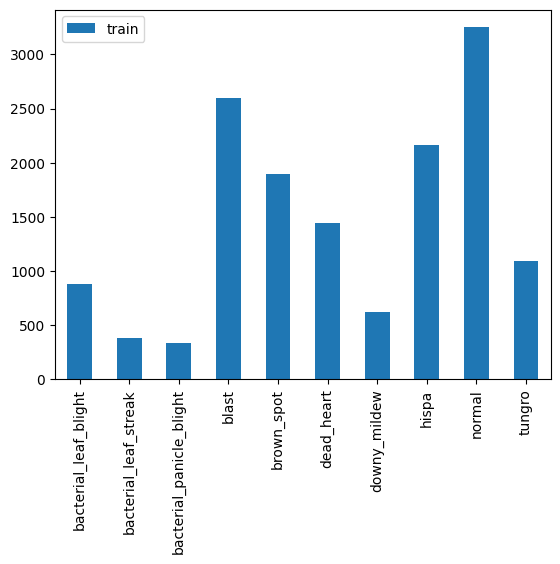

In [7]:
train_count.transpose().plot(kind = 'bar')

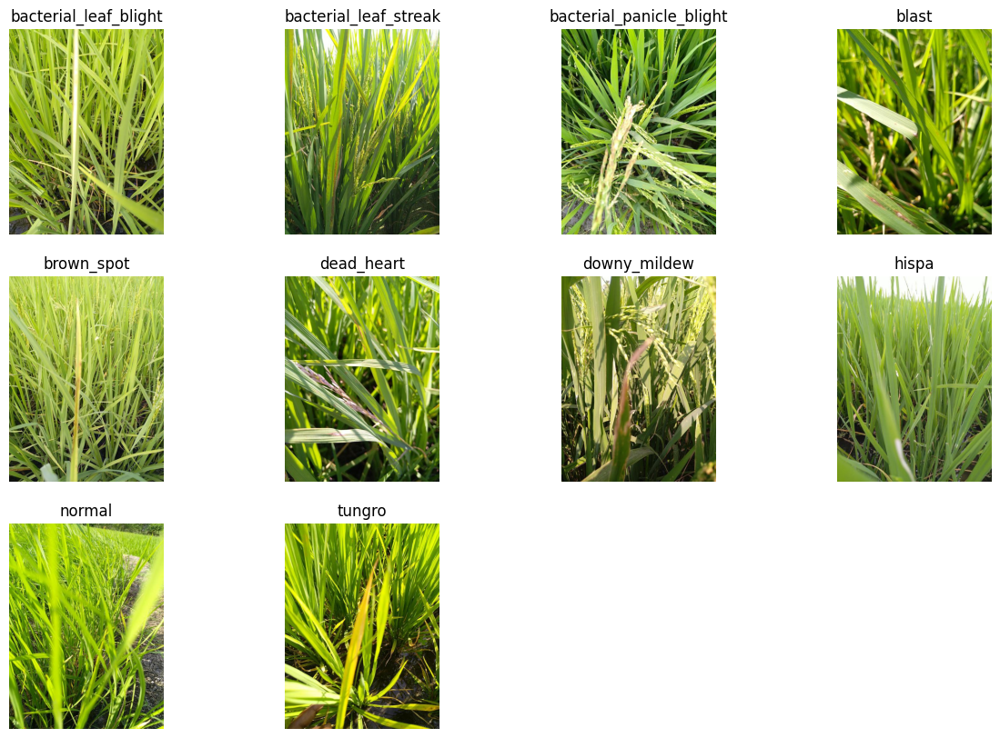

In [8]:
diseases = os.listdir(train_direct)

plt.figure(figsize = (15,10))

for i, disease in enumerate(diseases, 1):
    folder = os.path.join(train_direct, disease)
    img_path = os.path.join(folder, os.listdir(folder)[30])
    img = plt.imread(img_path)
    plt.subplot(3,4,i)
    plt.imshow(img)
    plt.title(disease)
    plt.axis('off')

In [9]:
def plot_image_from_direct(directory_path, class_name, nun_image = 9):
    image_filenames = os.listdir(directory_path)
    
    if nun_image > len(image_filenames):
            num_image = len(image_filenames)
            print(f'There are only {nun_image} image in this directory: {directory_path}')
    
    selected_images = random.sample(image_filenames, nun_image)
    
    fig,axes = plt.subplots(3,3, figsize = (15, 15))
    axes= axes.ravel()
    
    for i, img_file in enumerate(selected_images):
        img_path = os.path.join(directory_path, img_file)
        
        img = load_img(img_path)
        axes[i].imshow(img)
        axes[i].set_title(f'{class_name}')
        axes[i].axis('off')
    plt.tight_layout()
    plt.show()
      

In [10]:
bacterial_leaf_blight_path = 'data/train/bacterial_leaf_blight'
bacterial_leaf_streak_path = "data/train/bacterial_leaf_streak"
bacterial_panicle_blight_path = 'data/train/bacterial_panicle_blight'
blast_path = 'data/train/blast'
brown_spot_path = "data/train/brown_spot"
dead_heart_path = 'data/train/dead_heart'
downy_mildew_path = "data/train/downy_mildew"
hispa_path = 'data/train/hispa'
normal = 'data/train/normal'
tungro_path = "data/train/tungro"


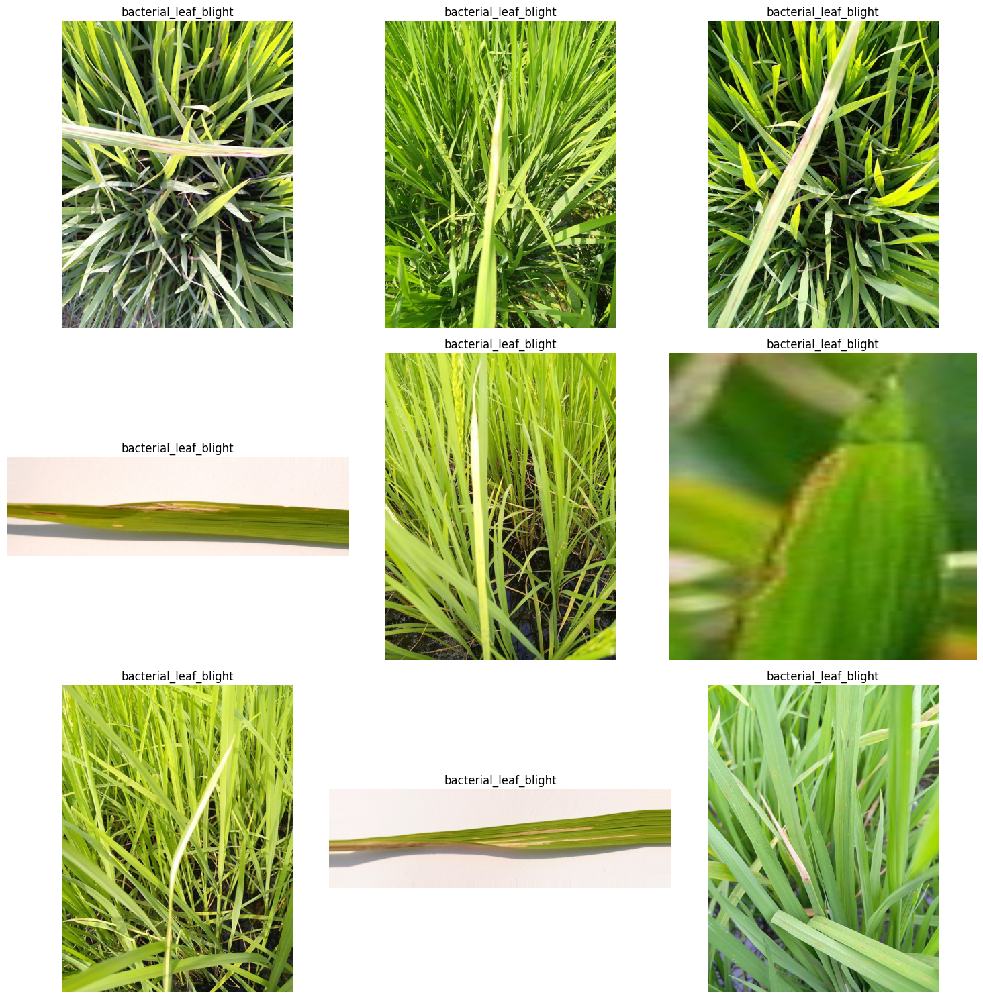

In [11]:
plot_image_from_direct(bacterial_leaf_blight_path, class_name = 'bacterial_leaf_blight')

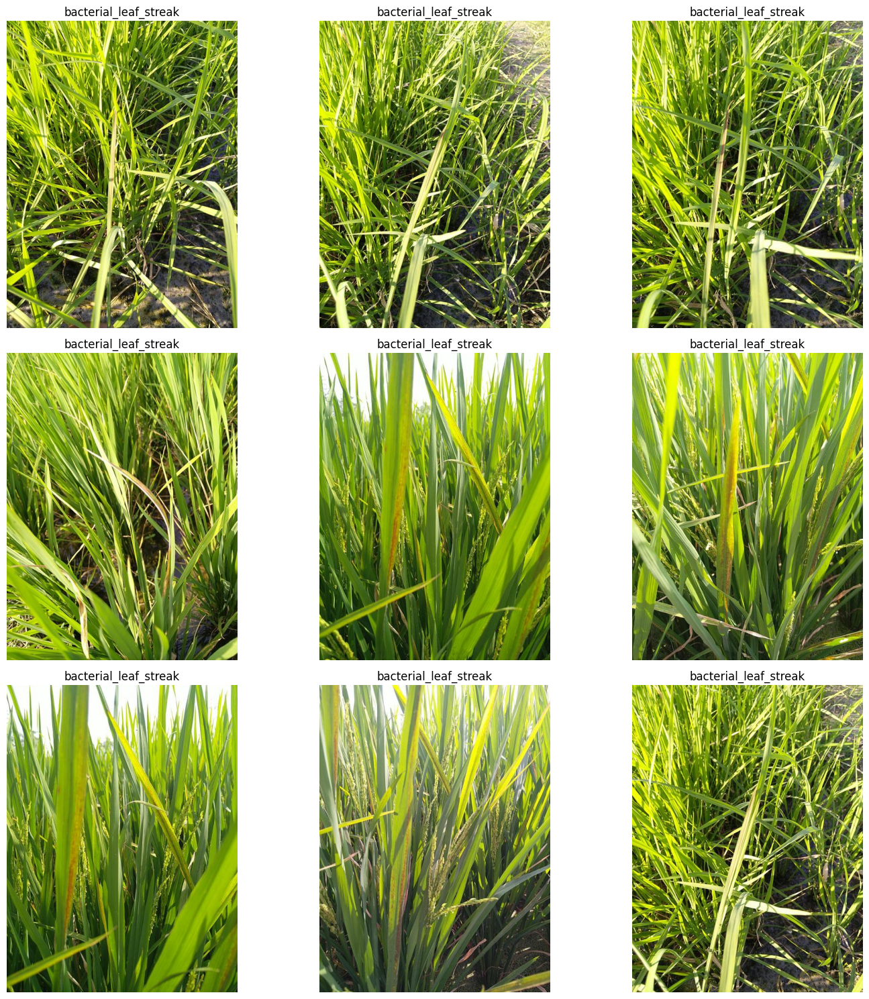

In [12]:
plot_image_from_direct(bacterial_leaf_streak_path, class_name = 'bacterial_leaf_streak')

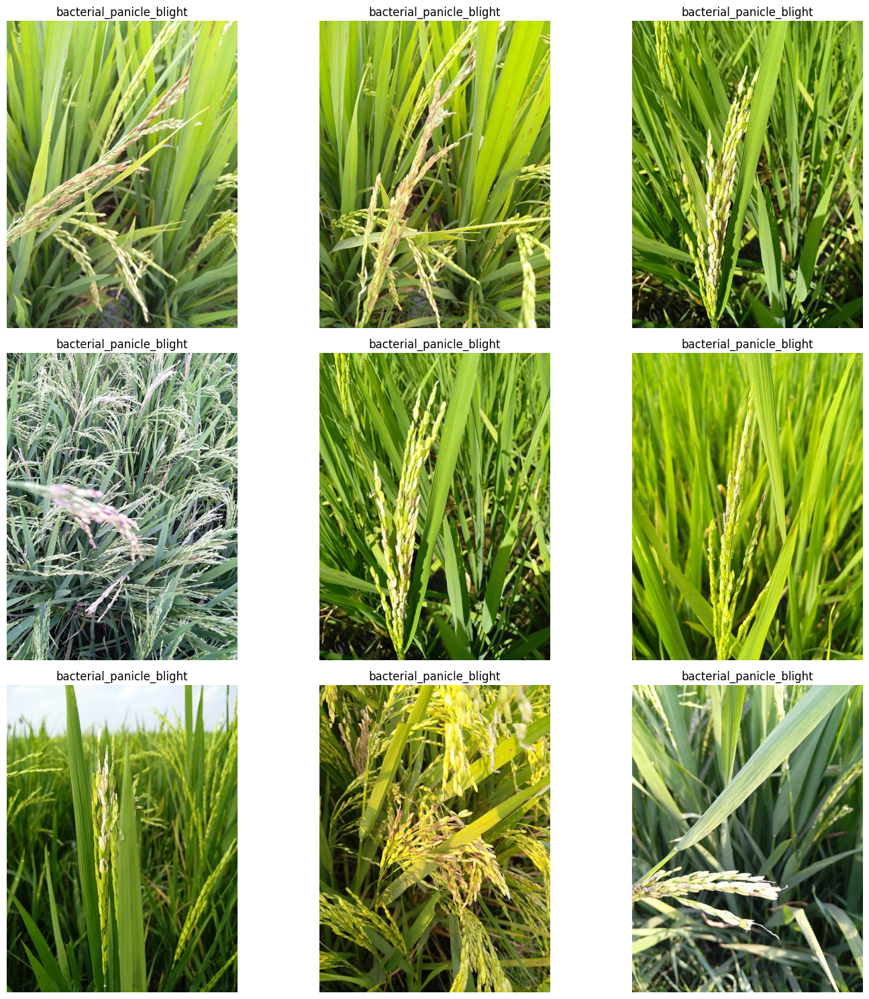

In [13]:
plot_image_from_direct(bacterial_panicle_blight_path, class_name = 'bacterial_panicle_blight')

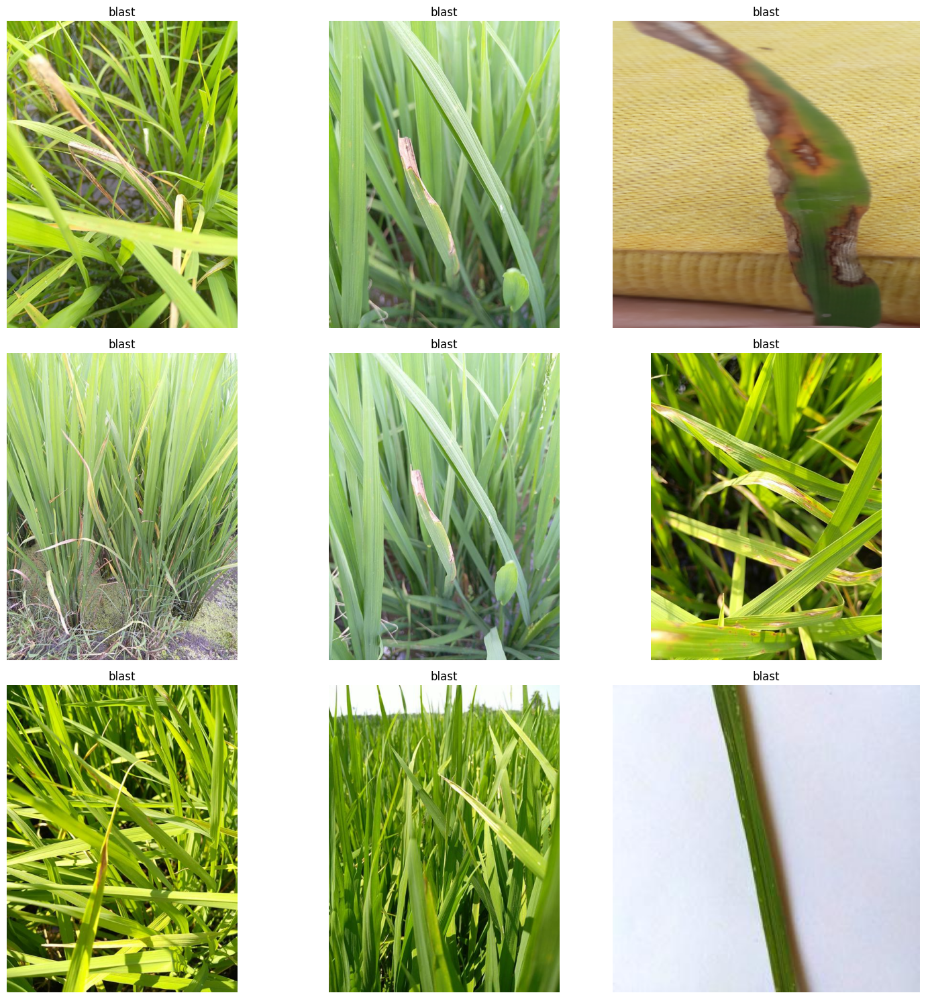

In [14]:
plot_image_from_direct(blast_path, class_name = 'blast')

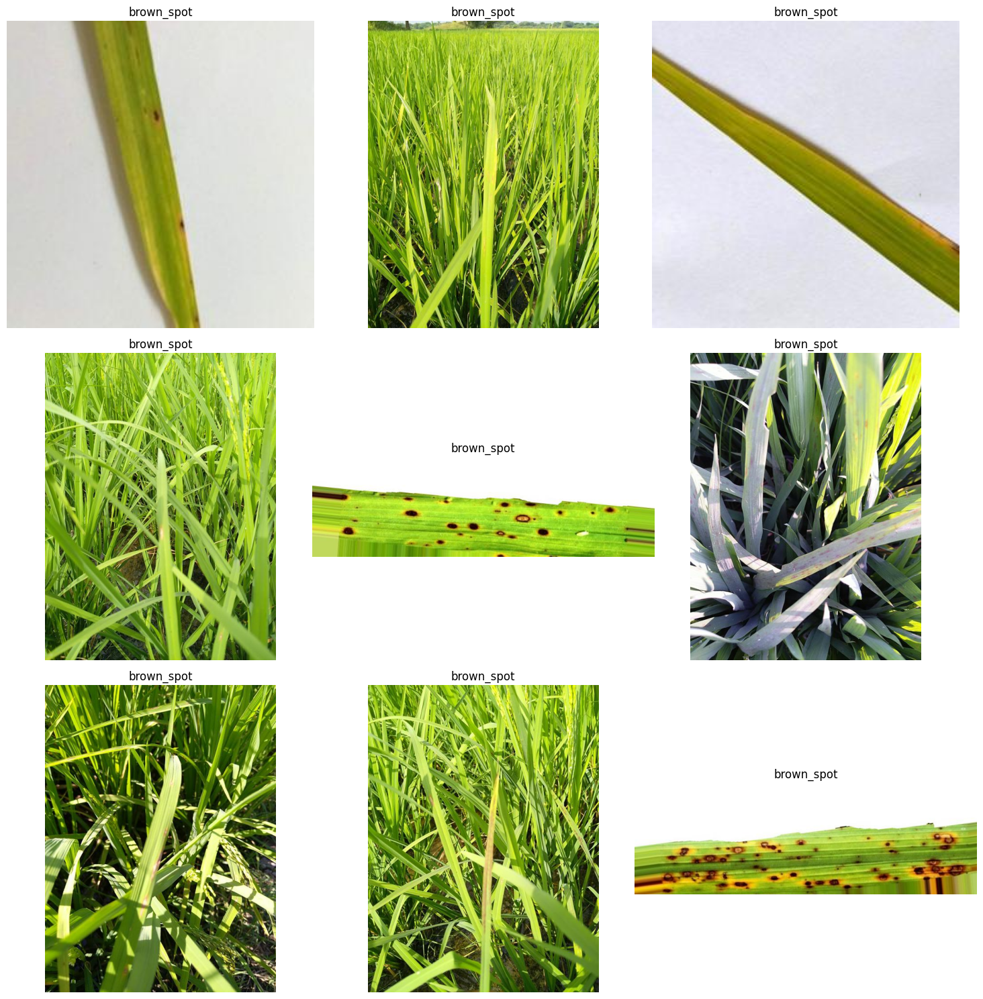

In [15]:
plot_image_from_direct(brown_spot_path, class_name = 'brown_spot')

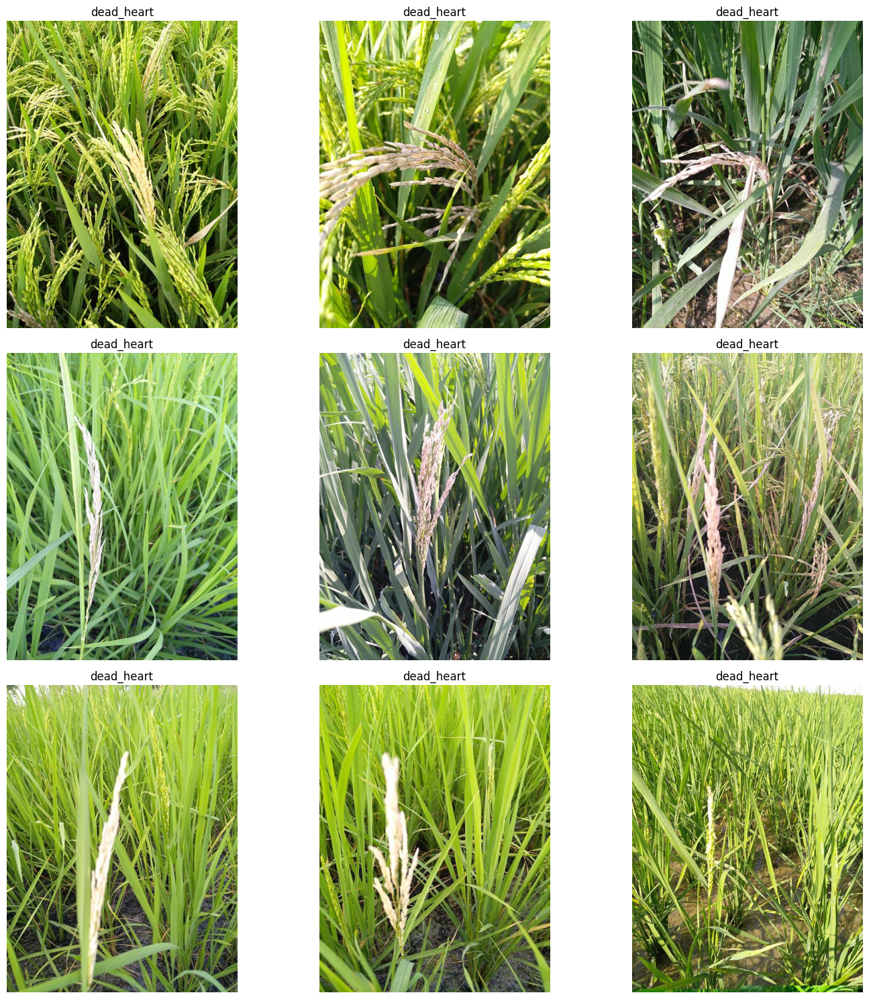

In [16]:
plot_image_from_direct(dead_heart_path, class_name = 'dead_heart')

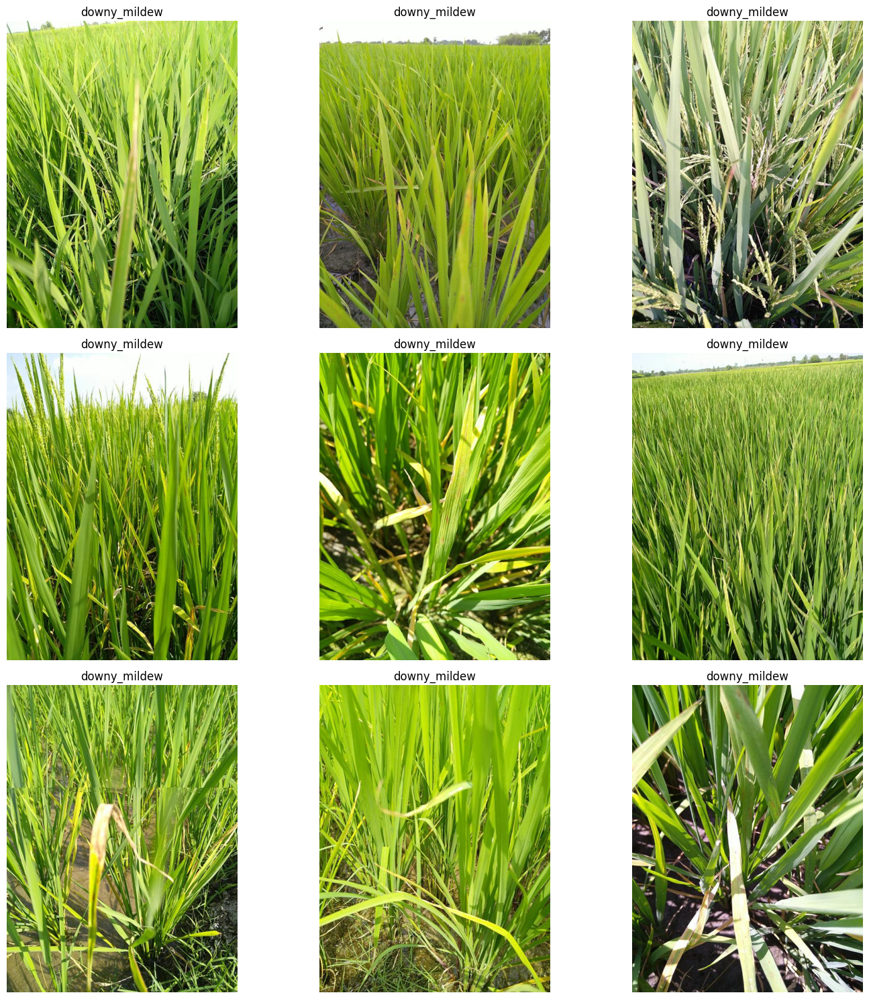

In [17]:
plot_image_from_direct(downy_mildew_path, class_name = 'downy_mildew')

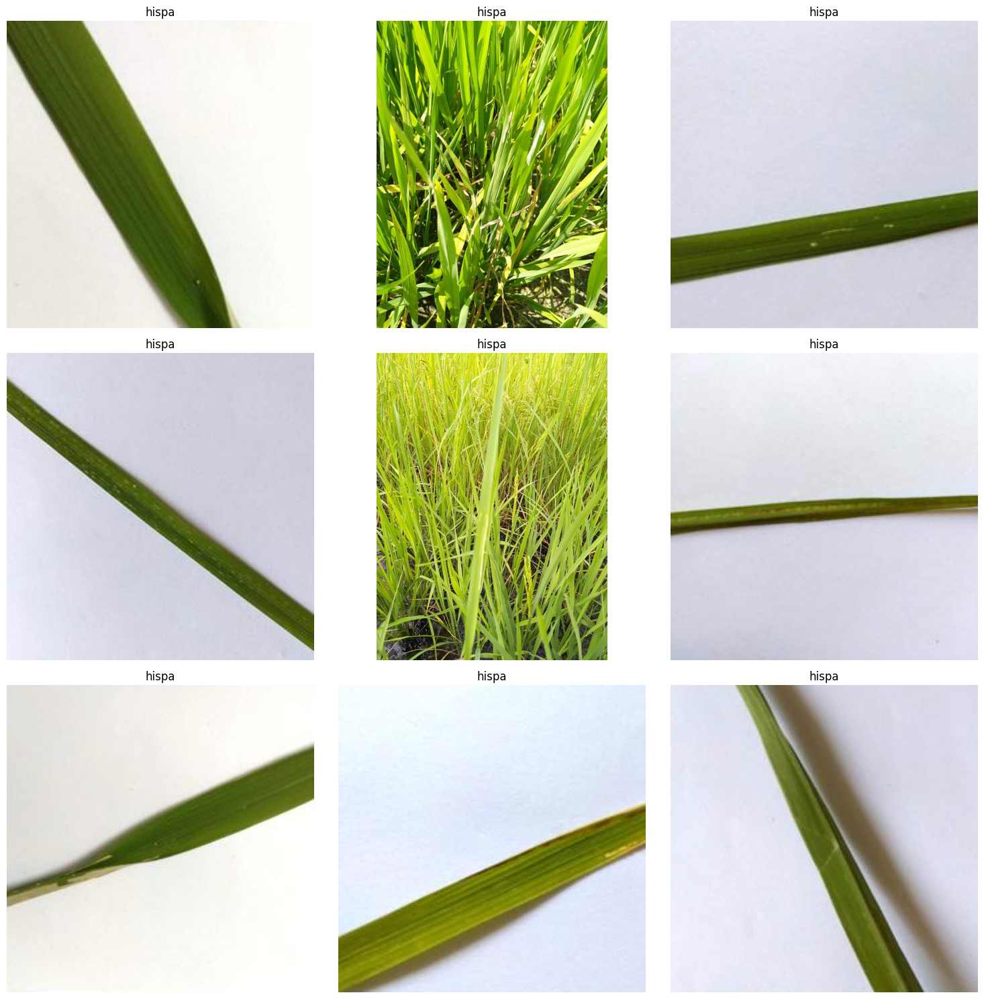

In [18]:
plot_image_from_direct(hispa_path, class_name = 'hispa')

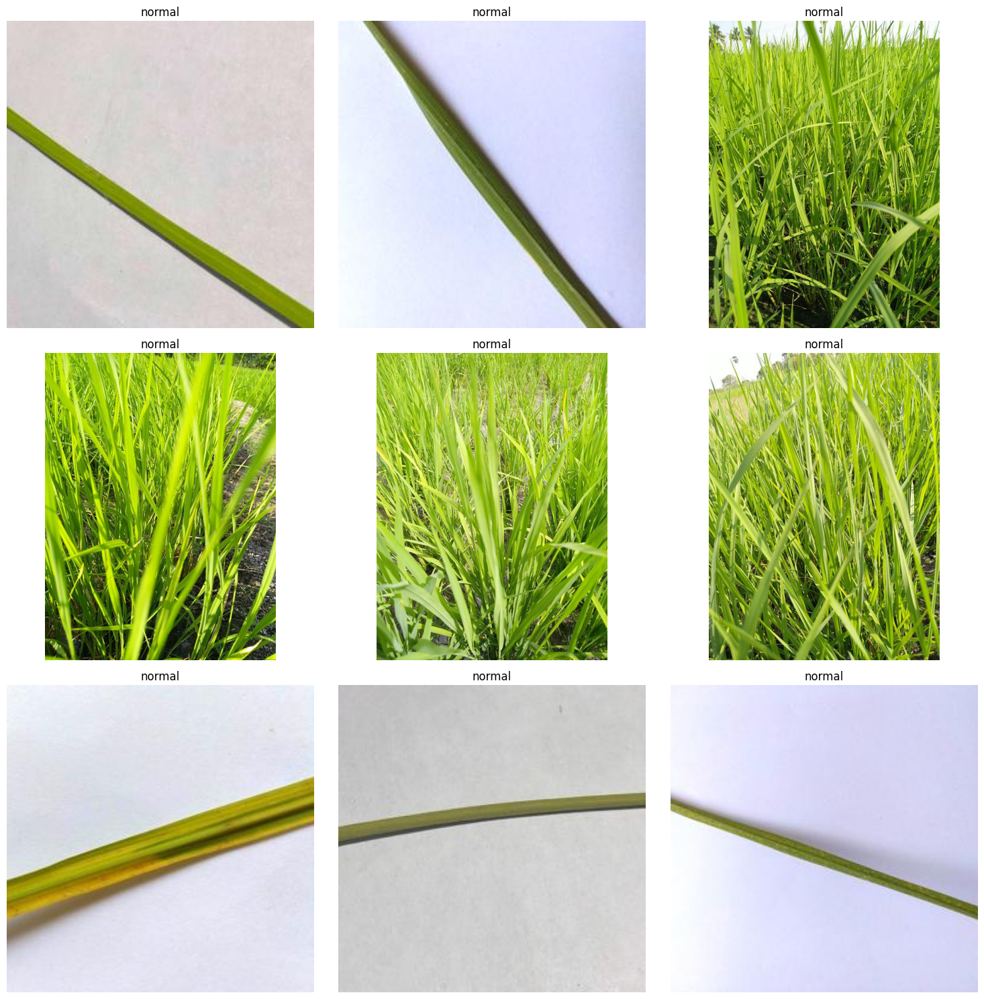

In [19]:
plot_image_from_direct(normal, class_name = 'normal')

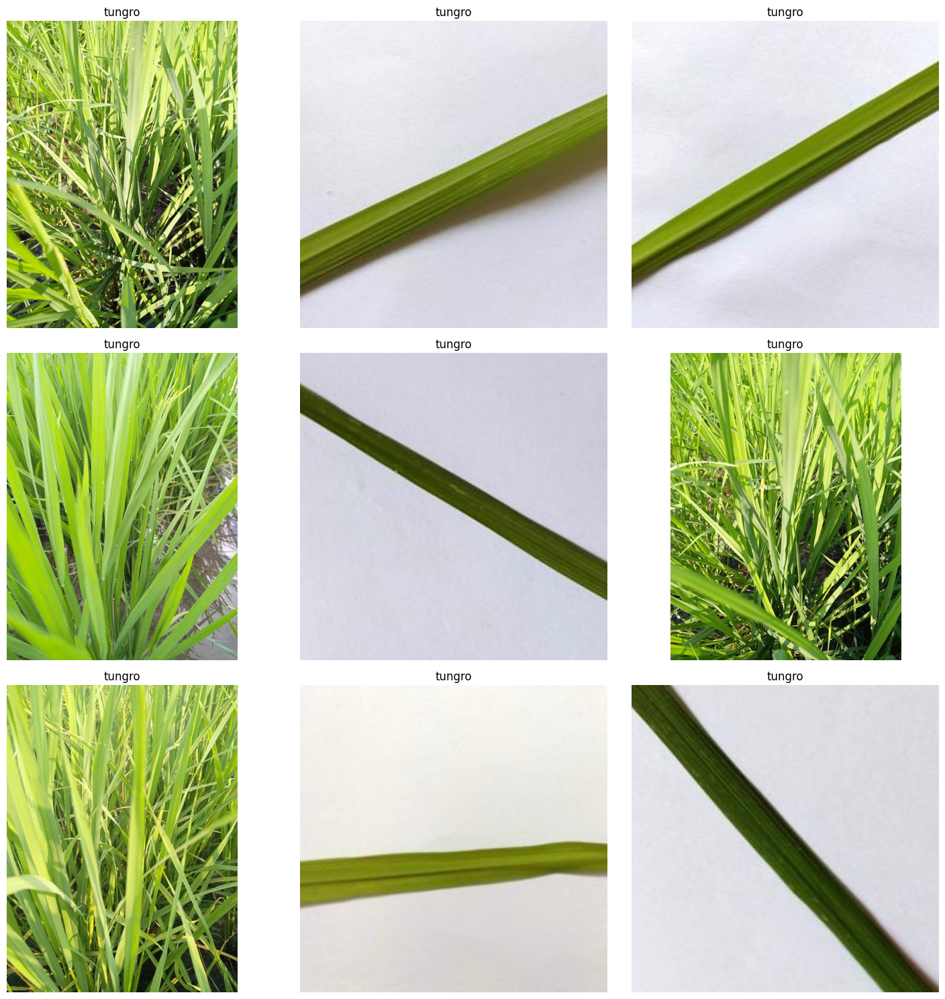

In [20]:
plot_image_from_direct(normal, class_name = 'tungro')

In [2]:
train_dir = 'data/train'
test_dir = 'data/test'

# Batch size for data generators
batch_size = 480


train_datagen = ImageDataGenerator(
                                  rescale=1 / 255.,  
                                  rotation_range=10,  
                                  zoom_range=0.2,  
                                  width_shift_range=0.1,  
                                  height_shift_range=0.1, 
                                  horizontal_flip=True, 
                                  fill_mode='nearest',
                                  validation_split = 0.2
    
                                 )

# Configuration for testing data (only rescaling)
test_datagen = ImageDataGenerator(
                                  rescale=1 / 255.  
                                 )

# Data generators for training and testing data
train_generator = train_datagen.flow_from_directory(
                                                    train_dir,  
                                                    class_mode="categorical",  
                                                    target_size=(224, 224), 
                                                    color_mode='rgb',  
                                                    shuffle=True,  
                                                    batch_size=batch_size,  
                                                    subset='training'  
                                                   )

test_generator = train_datagen.flow_from_directory(
                                                  train_dir,  # Directory containing testing data
                                                  class_mode="categorical",  # Classification mode for categorical labels
                                                  target_size=(224, 224),  # Resize input images to (224,224)
                                                  color_mode="rgb",  # Color mode for images (RGB)
                                                  shuffle=False,  # Do not shuffle testing data
                                                  batch_size=batch_size,  # Batch size for testing
                                                  subset = 'validation'  
                                                 )


Found 11720 images belonging to 10 classes.
Found 2926 images belonging to 10 classes.


In [3]:
import tensorflow as tf

# Define GPU options with a specified memory fraction (e.g., 0.8 for 80%)
gpu_options = tf.compat.v1.GPUOptions(per_process_gpu_memory_fraction=1.0)

# Create a TensorFlow session with the configured GPU options
sess = tf.compat.v1.Session(config=tf.compat.v1.ConfigProto(gpu_options=gpu_options))

In [4]:
classes = np.array(train_generator.classes)


class_weights = compute_class_weight(
    class_weight='balanced',  # Strategy to balance classes
    classes=np.unique(classes),  # Unique class labels
    y=classes  # Class labels for each instance in the training dataset
)

# Create a dictionary mapping class indices to their calculated weights
class_weights_dict = dict(enumerate(class_weights))

# Output the class weights dictionary
print("Class Weights Dictionary:", class_weights_dict)

Class Weights Dictionary: {0: 1.6647727272727273, 1: 3.8552631578947367, 2: 4.340740740740741, 3: 0.5640038498556305, 4: 0.7746199603436881, 5: 1.0155979202772965, 6: 2.3629032258064515, 7: 0.6782407407407407, 8: 0.4504227517294389, 9: 1.3455797933409874}


In [5]:
ResNet50V2 = tf.keras.applications.ResNet50V2(input_shape=(224, 224, 3),
                                               include_top= False,
                                               weights='imagenet'
                                               )

In [6]:
ResNet50V2.trainable = True

for layer in ResNet50V2.layers[:-50]:
    layer.trainable = False

In [7]:
def Create_ResNet50V2_Model():

    model = Sequential([
                      ResNet50V2,
                      Dropout(0.25),
                      BatchNormalization(),
                      Flatten(),
                      Dense(64, activation='relu'),
                      BatchNormalization(),
                      Dropout(0.5),
                      Dense(10,activation='softmax')
                    ])
    return model

In [8]:
model = Create_ResNet50V2_Model()
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet50v2 (Functional)     (None, 7, 7, 2048)        23564800  
                                                                 
 dropout (Dropout)           (None, 7, 7, 2048)        0         
                                                                 
 batch_normalization (BatchN  (None, 7, 7, 2048)       8192      
 ormalization)                                                   
                                                                 
 flatten (Flatten)           (None, 100352)            0         
                                                                 
 dense (Dense)               (None, 64)                6422592   
                                                                 
 batch_normalization_1 (Batc  (None, 64)               256       
 hNormalization)                                        

In [9]:
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

In [10]:
# File path for the model checkpoint
cnn_path = 'Paddy_Disease_Detection'
name = 'ResNet50_Transfer_Learning.keras'
chk_path = os.path.join(cnn_path, name)

# Callback to save the model checkpoint
checkpoint = ModelCheckpoint(filepath=chk_path,
                             save_best_only=True,
                             verbose=1,
                             mode='min',
                             monitor='val_loss')

# Callback for early stopping
earlystop = EarlyStopping(monitor = 'val_accuracy',
                          patience = 12,
                          restore_best_weights = True,
                          verbose=1)

# Callback to reduce learning rate
reduce_lr = ReduceLROnPlateau(monitor='val_loss',
                              factor=0.2,
                              patience=2,
#                             min_lr=0.00005,
                              verbose=1)

# Callback to log training data to a CSV file
csv_logger = CSVLogger(os.path.join(cnn_path,'training.log'))

# Aggregating all callbacks into a list
callbacks = [checkpoint, earlystop, csv_logger]  # Adjusted as per your use-case

train_steps_per_epoch = train_generator.samples // train_generator.batch_size + 1
# validation_steps_epoch = validation_generator.samples // validation_generator.batch_size + 1
test_steps_epoch = test_generator.samples // test_generator.batch_size + 1

In [11]:
gpus = tf.config.experimental.list_physical_devices('GPU')
print(gpus)
#tf.config.set_visible_devices([], 'CPU') # hide the CPU
tf.config.set_visible_devices(gpus[0], 'GPU') # unhide potentially hidden GPU
tf.config.get_visible_devices()

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


[PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU'),
 PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

In [12]:
train_history = model.fit(
                          train_generator,
                          steps_per_epoch=train_steps_per_epoch,
                          epochs=100,
                          validation_data=test_generator,
                          validation_steps=test_steps_epoch,
                          class_weight=class_weights_dict,
                          callbacks = callbacks
                         )

Epoch 1/100
25/25 [==============================] - ETA: 0s - loss: 1.6784 - accuracy: 0.3683
Epoch 1: val_loss improved from inf to 17.52170, saving model to Paddy_Disease_Detection\ResNet50_Transfer_Learning.keras
25/25 [==============================] - 239s 8s/step - loss: 1.6784 - accuracy: 0.3683 - val_loss: 17.5217 - val_accuracy: 0.1353
Epoch 2/100
25/25 [==============================] - ETA: 0s - loss: 0.9216 - accuracy: 0.6228
Epoch 2: val_loss improved from 17.52170 to 14.17107, saving model to Paddy_Disease_Detection\ResNet50_Transfer_Learning.keras
25/25 [==============================] - 169s 7s/step - loss: 0.9216 - accuracy: 0.6228 - val_loss: 14.1711 - val_accuracy: 0.2324
Epoch 3/100
25/25 [==============================] - ETA: 0s - loss: 0.6878 - accuracy: 0.7187
Epoch 3: val_loss improved from 14.17107 to 5.84442, saving model to Paddy_Disease_Detection\ResNet50_Transfer_Learning.keras
25/25 [==============================] - 183s 7s/step - loss: 0.6878 - accurac

Epoch 28/100
25/25 [==============================] - ETA: 0s - loss: 0.1336 - accuracy: 0.9372
Epoch 28: val_loss did not improve from 0.39666
25/25 [==============================] - 181s 7s/step - loss: 0.1336 - accuracy: 0.9372 - val_loss: 0.6648 - val_accuracy: 0.8571
Epoch 29/100
25/25 [==============================] - ETA: 0s - loss: 0.1395 - accuracy: 0.9323
Epoch 29: val_loss did not improve from 0.39666
25/25 [==============================] - 183s 7s/step - loss: 0.1395 - accuracy: 0.9323 - val_loss: 0.5257 - val_accuracy: 0.8831
Epoch 30/100
25/25 [==============================] - ETA: 0s - loss: 0.1309 - accuracy: 0.9387
Epoch 30: val_loss did not improve from 0.39666
25/25 [==============================] - 182s 7s/step - loss: 0.1309 - accuracy: 0.9387 - val_loss: 0.4376 - val_accuracy: 0.8968
Epoch 31/100
25/25 [==============================] - ETA: 0s - loss: 0.1092 - accuracy: 0.9435
Epoch 31: val_loss improved from 0.39666 to 0.31259, saving model to Paddy_Disease

In [14]:
def plot_training_history(history):

  acc = history.history['accuracy']
  val_acc = history.history['val_accuracy']
  loss = history.history['loss']
  val_loss = history.history['val_loss']

  epochs_range = range(len(acc))
  plt.figure(figsize = (20, 5))


  # Plot training and validation accuracy
  plt.subplot(1, 2, 1)
  plt.plot(epochs_range, acc, label='Training Accuracy')
  plt.plot(epochs_range, val_acc, label='Validation Accuracy')
  plt.legend(loc='lower right')
  plt.title('Training and Validation Accuracy')

  # Plot training and validation loss
  plt.subplot(1, 2, 2)
  plt.plot(epochs_range, loss, label='Training Loss')
  plt.plot(epochs_range, val_loss, label='Validation Loss')
  plt.legend(loc='upper right')
  plt.title('Training and Validation Loss')

  plt.show()

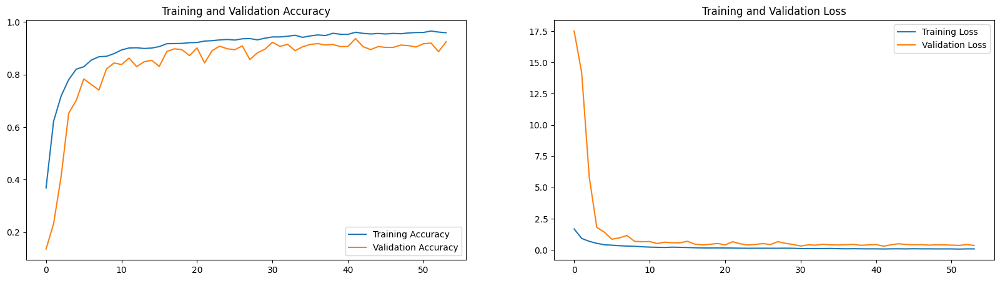

In [15]:
plot_training_history(train_history)

In [16]:
print(train_history.history.keys())

dict_keys(['loss', 'accuracy', 'val_loss', 'val_accuracy'])


7/7 [==============================] - 20s 3s/step


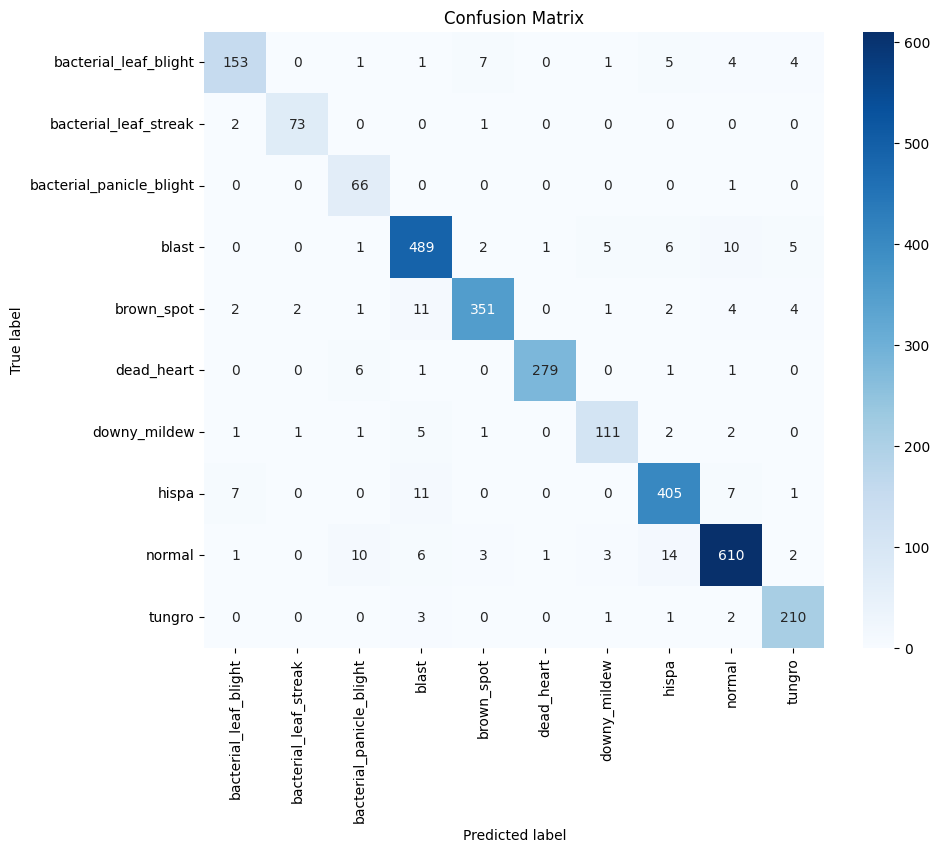

In [17]:
true_classes = test_generator.classes
predicted_classes = np.argmax(model.predict(test_generator, steps=np.ceil(test_generator.samples/test_generator.batch_size)), axis=1)
class_labels = list(test_generator.class_indices.keys())

# Generate the confusion matrix
cm = confusion_matrix(true_classes, predicted_classes)

# Plotting with seaborn
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=class_labels, yticklabels=class_labels)
plt.title('Confusion Matrix')
plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.show()

In [19]:
model.save('location.keras')

In [18]:
report = classification_report(true_classes,
                               predicted_classes,
                               target_names=class_labels,
                               zero_division=0)
print("Classification Report:\n", report)

Classification Report:
                           precision    recall  f1-score   support

   bacterial_leaf_blight       0.92      0.87      0.89       176
   bacterial_leaf_streak       0.96      0.96      0.96        76
bacterial_panicle_blight       0.77      0.99      0.86        67
                   blast       0.93      0.94      0.93       519
              brown_spot       0.96      0.93      0.94       378
              dead_heart       0.99      0.97      0.98       288
            downy_mildew       0.91      0.90      0.90       124
                   hispa       0.93      0.94      0.93       431
                  normal       0.95      0.94      0.95       650
                  tungro       0.93      0.97      0.95       217

                accuracy                           0.94      2926
               macro avg       0.93      0.94      0.93      2926
            weighted avg       0.94      0.94      0.94      2926



In [24]:
train_class_labels = train_generator.class_indices
print("Training class labels:", train_class_labels)


Training class labels: {'bacterial_leaf_blight': 0, 'bacterial_leaf_streak': 1, 'bacterial_panicle_blight': 2, 'blast': 3, 'brown_spot': 4, 'dead_heart': 5, 'downy_mildew': 6, 'hispa': 7, 'normal': 8, 'tungro': 9}


In [20]:
train_loss, train_accu = model.evaluate(train_generator)
test_loss, test_accu = model.evaluate(test_generator)
print("final train accuracy = {:.2f} , validation accuracy = {:.2f}".format(train_accu*100, test_accu*100))

7/7 [==============================] - 23s 3s/step - loss: 0.2765 - accuracy: 0.9398
final train accuracy = 96.51 , validation accuracy = 93.98


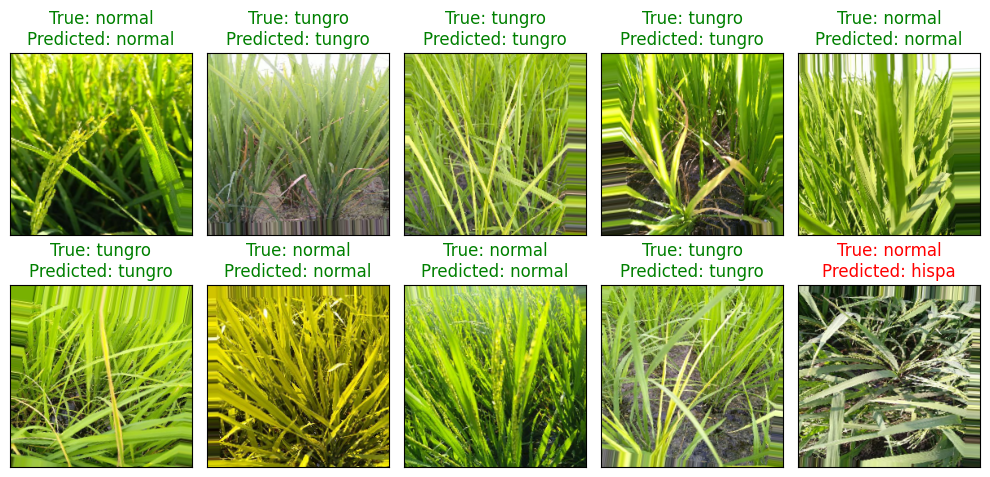

In [25]:
# Emotion classes for the dataset
Disease = ['bacterial_leaf_blight', 'bacterial_leaf_streak', 'bacterial_panicle_blight', 'blast', 'brown_spot', 'dead_heart', 'downy_mildew', 'hispa', 'normal', 'tungro']

# Assuming test_generator and model are already defined
batch_size = test_generator.batch_size

# Selecting a random batch from the test generator
Random_batch = np.random.randint(0, len(test_generator) - 1)

# Selecting random image indices from the batch
Random_Img_Index = np.random.randint(0, batch_size, 10)

# Setting up the plot
fig, axes = plt.subplots(nrows=2, ncols=5, figsize=(10, 5),
                         subplot_kw={'xticks': [], 'yticks': []})

for i, ax in enumerate(axes.flat):
    # Fetching the random image and its label
    Random_Img = test_generator[Random_batch][0][Random_Img_Index[i]]
    Random_Img_Label = np.argmax(test_generator[Random_batch][1][Random_Img_Index[i]], axis=0)

    # Making a prediction using the model
    Model_Prediction = np.argmax(model.predict(tf.expand_dims(Random_Img, axis=0), verbose=0), axis=1)[0]

    # Displaying the image
    ax.imshow(Random_Img.squeeze(), cmap='gray')  # Assuming the images are grayscale
    # Setting the title with true and predicted labels, colored based on correctness
    color = "green" if Disease[Random_Img_Label] == Disease[Model_Prediction] else "red"
    ax.set_title(f"True: {Disease[Random_Img_Label]}\nPredicted: {Disease[Model_Prediction]}", color=color)

plt.tight_layout()
plt.show()

1/1 [==============================] - 3s 3s/step


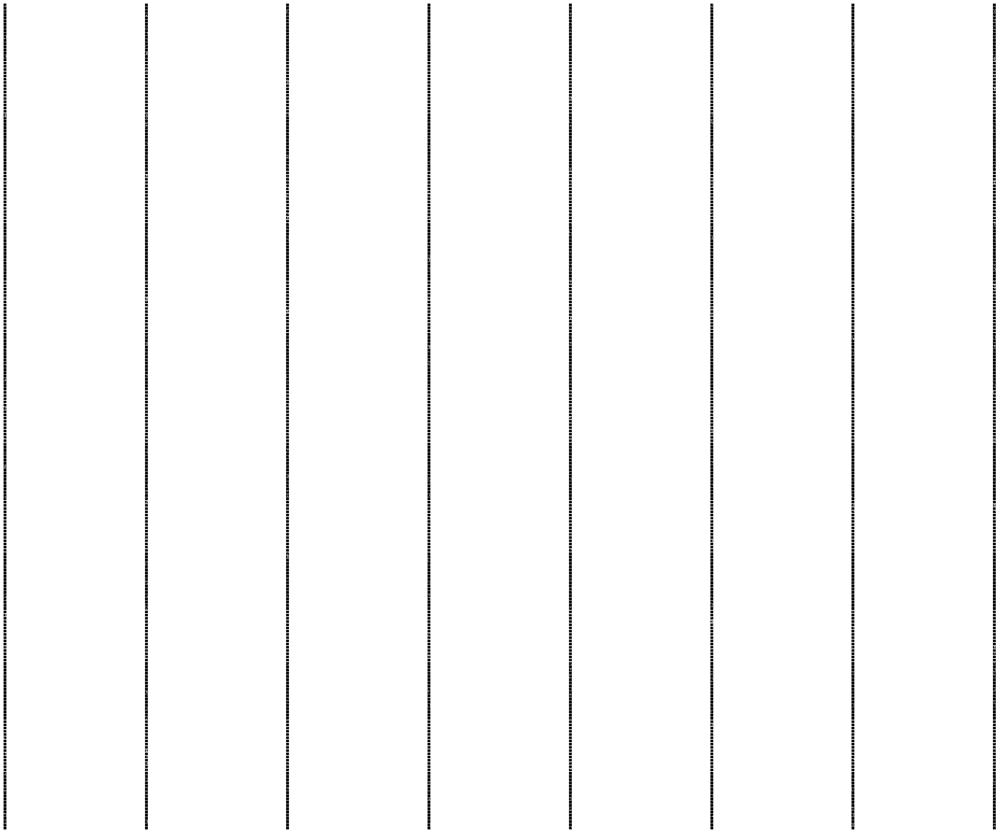

In [41]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import load_img, img_to_array
import tensorflow as tf

# Assuming 'model' is your pre-trained CNN model
model2 = tf.keras.Model(inputs=model.inputs, outputs=model.layers[1].output)

# Load and preprocess the image
image = load_img("1.png", target_size=(224, 224))
image = img_to_array(image)
image = np.expand_dims(image, axis=0)
image /= 255.0

# Predicting using model2 to get the features from the desired layer
features = model2.predict(image)

# Calculate the number of grids dynamically
num_feature_maps = features.shape[-1]
num_cols = 8  # You can adjust this number based on your preference
num_rows = num_feature_maps // num_cols + (1 if num_feature_maps % num_cols else 0)

fig = plt.figure(figsize=(40, 30))
for i in range(1, num_feature_maps + 1):
    ax = fig.add_subplot(num_rows, num_cols, i)
    ax.imshow(features[0, :, :, i-1], cmap='gray')
    plt.axis('off')


plt.show()